In [39]:
import torch
import torch.nn as nn

import matplotlib.pyplot as plt
import numpy as np
import time

import shutil

import pandas as pd
from scipy.io import loadmat
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
import torch.nn.functional as F
import copy
import scipy.io
import time
np.random.seed(14894)
torch.manual_seed(14894)

## Defining Hyperparameter

In [41]:
hyper_params_ENCODER={'input_size':1,'hidden_size':70,'num_layer':1,'encoded_size':3}

hyper_params_DECODER={'encoded_size':3,'hidden_size':70,'num_layer':1,'decoded_size':1}

device = torch.device('cpu')

print(device)

print_freq = 400


trainer_info = {'epochs': 300,
                'train_size': 4501,
                'train_batch': 16,
                'test_batch': 256,
                'lr0':0.8e-3,
                'lr_decay': 0.50}


note = 'LSTM_Spatial_Encoder'
model_name = 'model' + '_' + str(trainer_info['train_size']) + 'train_' + str(hyper_params_ENCODER['num_layer']) + 'layer_' + str(hyper_params_DECODER['hidden_size']) + 'hid_' + str(trainer_info['epochs']) + 'ep_' + note



cpu


## Defining Model

In [8]:
class LSTM_encoder(torch.nn.Module):

    def __init__(self,hyper_params_ENCODER):
        super().__init__()
        input_size = hyper_params_ENCODER['input_size']
        self.hidden_size = hyper_params_ENCODER['hidden_size']
        self.num_layers = hyper_params_ENCODER['num_layer']
        self.reduced_size = hyper_params_ENCODER['encoded_size']
        self.leakrelu = torch.nn.LeakyReLU()
        self.tanh=torch.nn.Tanh()
        self.LSTM = torch.nn.LSTM(input_size, self.hidden_size, self.num_layers,bidirectional=False, batch_first=True)
        self.fc1 = torch.nn.Linear(self.hidden_size, self.reduced_size)
       

    def forward(self, x):
        a0 = torch.zeros(self.num_layers, x.shape[0], self.hidden_size).to(device)
        c0 = torch.zeros(self.num_layers, x.shape[0], self.hidden_size).to(device)
        
        '''a0=torch.randn((self.num_layers, x.shape[0], self.hidden_size), dtype=torch.float).to(device)
        c0=torch.randn((self.num_layers, x.shape[0], self.hidden_size), dtype=torch.float).to(device)'''
            
        out, (a,c) = self.LSTM(x, (a0,c0))

        out = self.leakrelu(out)
        out = self.fc1(out)
        #out=self.tanh(out)
   
        return out,x,(a,c)

class LSTM_decoder(torch.nn.Module):

    def __init__(self,hyper_params_DECODED,coord):
        super().__init__()

        self.reduced_size = hyper_params_DECODED['encoded_size']
        self.hidden_size = hyper_params_DECODED['hidden_size']
        self.num_layers = hyper_params_DECODED['num_layer']
        self.input_size = hyper_params_DECODED['decoded_size']
        self.coord=coord

        self.leakrelu = torch.nn.LeakyReLU()
        self.tanh= torch.nn.Tanh()
        self.LSTM = torch.nn.LSTM(self.reduced_size, self.hidden_size, self.num_layers, batch_first=True)
        self.fc1 = torch.nn.Linear(self.hidden_size, self.input_size)
        

    '''def forward(self, a0_init,x,aa0,cc0):

    # a0_init = self.fc1(a00)
    #a0 = torch.zeros(self.num_layers, a0_init.shape[0], self.hidden_size).to(device)
    #c0 = torch.zeros(self.num_layers, a0_init.shape[0], self.hidden_size).to(device) # My method

    a0 = torch.zeros(self.num_layers, a0_init.shape[0], self.reduced_size).to(device)


    #print(a0_init.shape)
    a0[0, :, :] = a0_init.clone()
    aug_a = a0_init.repeat(1, x.shape[1]).reshape(a0_init.shape[0],

                                           x.shape[1], a0_init.shape[1])

    #c0[0, :, :] = a0_init.clone()  # My moethod


    #print(aug_a.shape)
    #print(samples[:,:,0].shape)

    coord1=self.coord.repeat(x.shape[0],1)

    aug_a1=torch.cat((aug_a,(coord1).unsqueeze(2).to(device).float()),dim=2)
    # inp = torch.cat(aug_a, axis=2)
    out, (a,c) = self.LSTM(aug_a1, (aa0,cc0))
    out = self.leakrelu(out)
    out = self.fc1(out)
    return out'''
        
    def forward(self, a0_init,x):

    # a0_init = self.fc1(a00)
        a0 = torch.zeros(self.num_layers, a0_init.shape[0], self.hidden_size).to(device)
        c0 = torch.zeros(self.num_layers, a0_init.shape[0], self.hidden_size).to(device)



        #print(a0_init.shape)
        #a0[:, :, :] = a0_init.repeat(a0.shape[0],1,1).clone()
        aug_a = a0_init.repeat(1, x.shape[1]).reshape(a0_init.shape[0],x.shape[1], a0_init.shape[1])

        #c0[:, :, :] = a0_init.repeat(a0.shape[0],1,1).clone()


        #print(aug_a.shape)
        #print(samples[:,:,0].shape)

        #coord1=self.coord.repeat(x.shape[0],1)

        #aug_a1=torch.cat((aug_a,(coord1).unsqueeze(2).to(device).float()),dim=2)
        # inp = torch.cat(aug_a, axis=2)
        
        inp=torch.zeros([a0_init.shape[0],x.shape[1], a0_init.shape[1]]).to(device)
        out, (a,c) = self.LSTM(aug_a, (a0,c0))
        out = self.leakrelu(out)
        
        out = self.fc1(out)
        #out = self.tanh(out)
        return out


class LSTM_encoder_decoder(torch.nn.Module):

    def __init__(self,hyper_params_ENCODER,hyper_params_DECODER,coord):
        super().__init__()

        self.encoder = LSTM_encoder(hyper_params_ENCODER)
        self.decoder = LSTM_decoder(hyper_params_DECODER,coord)
        self.coord=coord
        
        self.init_weights()

    def init_weights(self):
        with torch.set_grad_enabled(True):
            
            for name, param in self.named_parameters():
                print(f"Initializing parameter '{name}' with shape: {param.shape}")
                if 'weight' in name:
                    nn.init.xavier_uniform_(param)
                    #nn.init.orthogonal_(param)
                elif 'bias' in name:
                    nn.init.constant_(param, 0.0)

    def forward(self, inp_encoder):
        with torch.set_grad_enabled(True):
            y_code,x,(a,c) = self.encoder(inp_encoder)
            #print(y_code[:, y_code.shape[1] - 1].shape)
            y_recovered = self.decoder(y_code[:, y_code.shape[1]-1],x)
            return y_recovered,y_code[:, y_code.shape[1] - 1]

## Utilities

In [9]:
class MinMax_Scaler(object):

    def __init__(self, data, keep_data=False):
        self.min = np.min(data, axis=(0, 1), keepdims=True)
        self.max = np.max(data, axis=(0, 1), keepdims=True)

        if keep_data is True:
            self.data = self.transform(data, tensor=False)
        else:
            self.data = []

    def transform(self, data, tensor_format=False):
        if tensor_format is False:
            data = (data - self.min) / (self.max - self.min)
        else:
            min_tensor = torch.tensor(self.min).to(device)
            max_tensor = torch.tensor(self.max).to(device)
            for c in range(data.shape[2]):
                data[:, :, c] = torch.div(torch.sub(data[:, :, c], min_tensor[0, 0, c]), torch.sub(max_tensor[0, 0, c], min_tensor[0, 0, c]))
        return data

    def inv_transform(self, data, tensor_format=False):
        if tensor_format is False:
            data = data * (self.max - self.min) + self.min
        else:
            min_tensor = torch.tensor(self.min).to(device)
            max_tensor = torch.tensor(self.max).to(device)
            for c in range(data.shape[2]):
                data[:, :, c] = torch.add(torch.mul(data[:, :, c], torch.sub(max_tensor[0, 0, c], min_tensor[0, 0, c])), min_tensor[0, 0, c])
        return data

class MyDataset(torch.utils.data.Dataset):

    def __init__(self, strain, stress):
        self.strain = strain
        self.stress = stress

    def __len__(self):
        return self.strain.shape[0]

    def __getitem__(self, index):
        return self.strain[index], self.stress[index]


class AverageMeter(object):
    # Computes and stores the average and current value

    def __init__(self):
        self.reset()

    def reset(self):
        self.val = 0
        self.avg = 0
        self.sum = 0
        self.count = 0

    def update(self, val, n=1):
        self.val = val
        self.sum += val * n
        self.count += n
        self.avg = self.sum / self.count


def customized_loss(output, target):

    mse = torch.nn.MSELoss()

    output1 = output[:, :, 0:3]
    output2 = output[:, :, 3:6]

    target1 = target[:, :, 0:3]
    target2 = target[:, :, 3:6]

    return 0.5 * torch.maximum(mse(output1, target1), mse(output2, target2))

def train_step(train_loader, model, criterion, optimizer, epoch, net_info):
    batch_time = AverageMeter()
    data_time = AverageMeter()
    losses = AverageMeter()

    # switch to train mode
    model.train()

    end = time.time()
    for i, (input, target) in enumerate(train_loader):
        # measure data loading time
        data_time.update(time.time() - end)

        input = input.to(device)
        target = target.to(device)

        # compute output
        output,enc = model(input)
    
        loss = criterion(output, target)
        
        #print(enc)
        # measure accuracy and record loss
        losses.update(loss.item(), input.size(0))

        # compute gradient and do the SGD step
        optimizer.zero_grad()
        loss.backward()
        
        '''for name, param in model.named_parameters():
            if param.grad is not None:
                print(f"Gradient for parameter '{name}':\n{param.grad}")
            else:
                print(f"No gradient for parameter '{name}'")'''

        # torch.nn.utils.clip_grad_norm_(model.parameters(), 0.1)
        optimizer.step()

        # measure elapsed time
        batch_time.update(time.time() - end)
        end = time.time()

        if epoch % 25 == 0:
            if i % print_freq == 0:
                curr_lr = optimizer.param_groups[0]['lr']
                print('Epoch: [{0}/{1}][{2}/{3}]\t'
                    'LR: {4}\t'
                    'Time {batch_time.val:.3f} ({batch_time.avg:.3f})\t'
                    'Data {data_time.val:.3f} ({data_time.avg:.3f})\t'
                    'Loss {loss.val:.7f} ({loss.avg:.6f})\t'.format(
                    epoch, net_info['epochs'], i, len(train_loader), curr_lr,
                    batch_time=batch_time, data_time=data_time, loss=losses))
    return losses.avg


def test_step(test_loader, model, criterion, epoch):
    batch_time = AverageMeter()
    losses = AverageMeter()
    # violation = AverageMeter()

    # switch to evaluate mode
    model.eval()

    end = time.time()
    for i, (input, target) in enumerate(test_loader):

        input = input.to(device)
        target = target.to(device)

        # compute output
        output,_ = model(input)
        loss = criterion(output, target)

        # measure accuracy and record loss
        losses.update(loss.item(), input.size(0))

        # measure elapsed time
        batch_time.update(time.time() - end)
        end = time.time()

        if epoch % 25 == 0:
            if i % print_freq == 0:
                print('Test: [{0}/{1}]\t'
                    'Time {batch_time.val:.3f} ({batch_time.avg:.3f})\t'
                    'Loss {loss.val:.7f} ({loss.avg:.4f})\t'.format(
                    i, len(test_loader), batch_time=batch_time, loss=losses))

    return losses.avg

#@title train_RNN()
def save_checkpoint(state, is_best, filename='checkpoint.pth.tar'):
    torch.save(state, filename)
    if is_best:
        shutil.copyfile(filename, 'model_best_LSTM_Spatial_Temperature_interpol_latest.pth.tar')


def train_LSTM_autoencoder(model, net_info, train_loader, test_loader,hyper_params_ENCODER, hyper_params_DECODER):

    epochs = net_info['epochs']
    train_losses = np.empty([epochs, 1])
    test_losses = np.empty([epochs, 1])

    min_loss = 1e4

    criterion = nn.MSELoss()
    optimizer = torch.optim.Adam(model.parameters(), lr=net_info['lr0'])#,weight_decay=1e-7)

    for epoch in range(epochs):
        # adjust learning rate
        if epoch >= 25:
            if epoch % 25== 0:
                for param_group in optimizer.param_groups:
                    param_group['lr'] *= net_info['lr_decay']

        # train for one epoch
        train_losses_temp = train_step(train_loader, model, criterion, optimizer, epoch, net_info)
        train_losses[epoch] = train_losses_temp

        # evaluate on test set
        test_losses_temp = test_step(test_loader, model, criterion, epoch)
        test_losses[epoch] = test_losses_temp

        # remember best MSE and save checkpoint
        is_best = test_losses[epoch] < min_loss
        min_loss = min(test_losses[epoch], min_loss)
        save_checkpoint({
            'epoch': epoch + 1,
            'state_dict': model.state_dict(),
            'min_loss': min_loss,
            'optimizer': optimizer.state_dict(),
        }, is_best)

    test_losses.tofile('test_loss' + str(net_info['train_size']) + '2l50h.csv', sep=",", format="%10.5f")
    train_losses.tofile('train_loss' + str(net_info['train_size']) + '2l50h.csv', sep=",", format="%10.5f")

    plt.figure(figsize=(10, 7))
    plt.plot(train_losses, label='training')
    plt.plot(test_losses, '--', label='test')
    plt.xlabel('epoch')
    plt.ylabel('MSE')
    plt.title('Training and Test Loss\n(hidden size=%s, num layers=%s model'%(hyper_params_ENCODER['hidden_size'],hyper_params_ENCODER['num_layer']))
    plt.yscale('log')
    plt.legend()
    plt.show()
    return model

#@title main_program()
def main_program(T_S, T_S_out,val_T_S, val_T_S_out,hyper_params_ENCODER, hyper_params_DECODER, model,trainer_info, model_name):
    num_sample = trainer_info['train_size']
    T_S_train = T_S[:, :, :]
    T_S_out_train = T_S_out[:, :, :]
    training_set = MyDataset(T_S_train, T_S_out_train)

    T_S_test = val_T_S[:, :, :]
    T_S_out_test = val_T_S_out[:, :, :]
    val_set = MyDataset(T_S_test, T_S_out_test)

    # create training/test loaders
    train_loader = torch.utils.data.DataLoader(dataset=training_set,
                                               batch_size=trainer_info['train_batch'],
                                               shuffle=True)

    test_loader = torch.utils.data.DataLoader(dataset=val_set,
                                              batch_size=trainer_info['test_batch'],
                                              shuffle=True)

    model = train_LSTM_autoencoder(model, trainer_info, train_loader, test_loader,hyper_params_ENCODER, hyper_params_DECODER)
    torch.save(model.state_dict(), model_name)

    return model



## Importing Data and Data preprocessing

In [10]:
# Interpolated to 50 data points and between 1500-3500.
import copy

data=loadmat("Input_ROM")



coordinates=pd.read_excel("coordinates.xlsx",header=None)
coord=coordinates.iloc[:].values.reshape(-1,1)
Input=data['TT'].astype(np.float32)
ZZ=copy.deepcopy(coord.T)
from scipy.interpolate import griddata
points=ZZ[0]
no_of_points=50
xi=np.linspace(-110,-0.15,no_of_points)

Input_inter=np.zeros((Input.shape[0],no_of_points,1))
for i in range(Input.shape[0]): 
    Input_inter[i,:,:]=griddata(points,Input[i,:,0:1],xi,method='cubic')
    
Input=Input_inter.astype(np.float32)

Input1=Input[0:1500,:,0:1]

Input2=Input[3300:8501,:,0:1]


Valx=Input[3000:3300,:,0:1].astype(np.float32)

x=np.concatenate([Input1,Input2],axis=0).astype(np.float32)


In=MinMax_Scaler(x)
x_tr=In.transform(x)
Valx_tr=In.transform(Valx)



#coord=coord[::6]




cord=MinMaxScaler()

coord=cord.fit_transform(coord)

coord=torch.from_numpy(coord).reshape(1,-1).float().to(device)

time=loadmat("Input_BC")
time=time['BC'].astype(np.float32)[:,0]

hours=time/(3600)

## Training

Initializing parameter 'encoder.LSTM.weight_ih_l0' with shape: torch.Size([280, 1])
Initializing parameter 'encoder.LSTM.weight_hh_l0' with shape: torch.Size([280, 70])
Initializing parameter 'encoder.LSTM.bias_ih_l0' with shape: torch.Size([280])
Initializing parameter 'encoder.LSTM.bias_hh_l0' with shape: torch.Size([280])
Initializing parameter 'encoder.fc1.weight' with shape: torch.Size([3, 70])
Initializing parameter 'encoder.fc1.bias' with shape: torch.Size([3])
Initializing parameter 'decoder.LSTM.weight_ih_l0' with shape: torch.Size([280, 3])
Initializing parameter 'decoder.LSTM.weight_hh_l0' with shape: torch.Size([280, 70])
Initializing parameter 'decoder.LSTM.bias_ih_l0' with shape: torch.Size([280])
Initializing parameter 'decoder.LSTM.bias_hh_l0' with shape: torch.Size([280])
Initializing parameter 'decoder.fc1.weight' with shape: torch.Size([1, 70])
Initializing parameter 'decoder.fc1.bias' with shape: torch.Size([1])
Epoch: [0/300][0/419]	LR: 0.0008	Time 0.104 (0.104)	Da

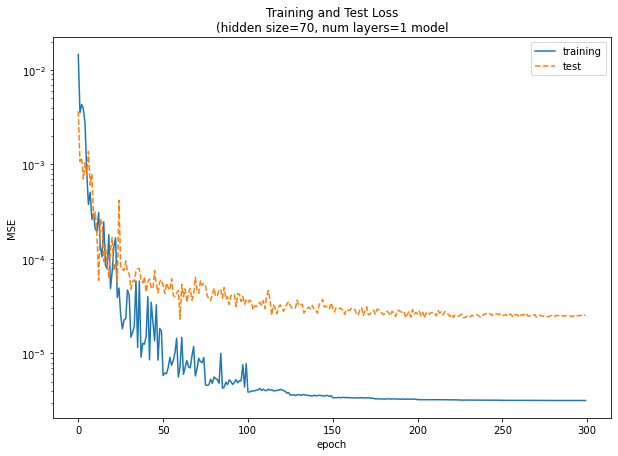

Total execution time: 1053.0649144649506 seconds


In [11]:
import time

start_time = time.time()
model=LSTM_encoder_decoder(hyper_params_ENCODER, hyper_params_DECODER,coord).to(device)
model = main_program(x_tr, x_tr,Valx_tr,Valx_tr,hyper_params_ENCODER, hyper_params_DECODER,model, trainer_info, model_name)
end_time = time.time()
# Calculate and print the total execution time
total_execution_time = end_time - start_time
print(f"Total execution time: {total_execution_time} seconds")

## Saving weights

In [12]:

best_model_params = torch.load('model_best_LSTM_Spatial_Temperature_interpol_latest.pth.tar', map_location=device)['state_dict']



## Loading weights

In [13]:
model=LSTM_encoder_decoder(hyper_params_ENCODER, hyper_params_DECODER,coord).to(device)
model.load_state_dict(best_model_params)

Initializing parameter 'encoder.LSTM.weight_ih_l0' with shape: torch.Size([280, 1])
Initializing parameter 'encoder.LSTM.weight_hh_l0' with shape: torch.Size([280, 70])
Initializing parameter 'encoder.LSTM.bias_ih_l0' with shape: torch.Size([280])
Initializing parameter 'encoder.LSTM.bias_hh_l0' with shape: torch.Size([280])
Initializing parameter 'encoder.fc1.weight' with shape: torch.Size([3, 70])
Initializing parameter 'encoder.fc1.bias' with shape: torch.Size([3])
Initializing parameter 'decoder.LSTM.weight_ih_l0' with shape: torch.Size([280, 3])
Initializing parameter 'decoder.LSTM.weight_hh_l0' with shape: torch.Size([280, 70])
Initializing parameter 'decoder.LSTM.bias_ih_l0' with shape: torch.Size([280])
Initializing parameter 'decoder.LSTM.bias_hh_l0' with shape: torch.Size([280])
Initializing parameter 'decoder.fc1.weight' with shape: torch.Size([1, 70])
Initializing parameter 'decoder.fc1.bias' with shape: torch.Size([1])


<All keys matched successfully>

In [14]:
time_step=10
time_step_test=10
encoded_size=3

## Validation 

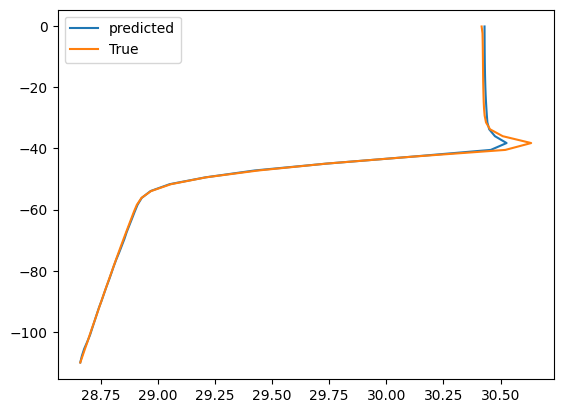

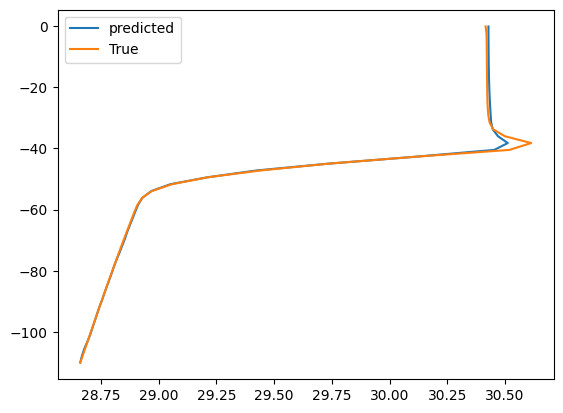

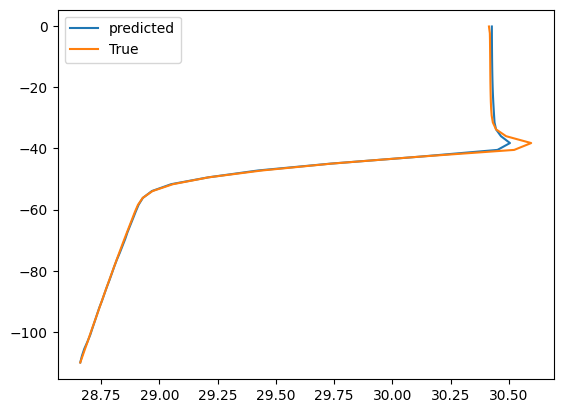

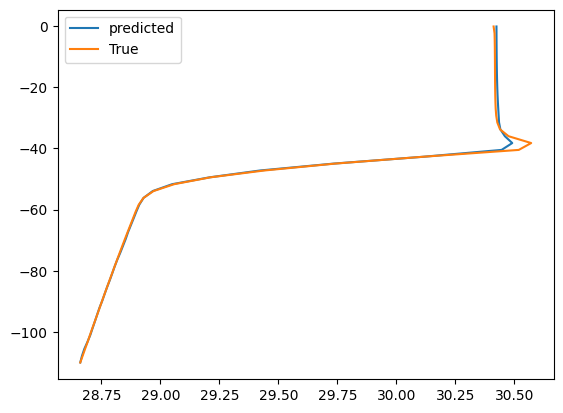

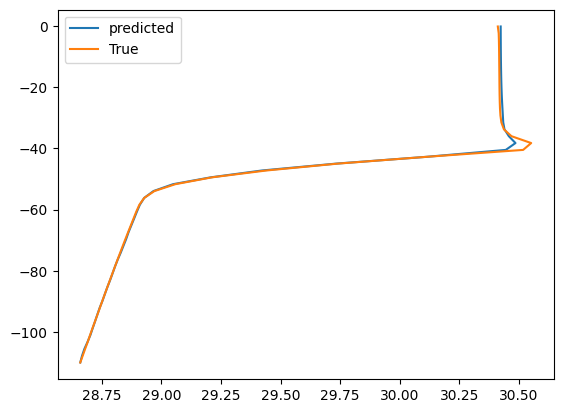

...

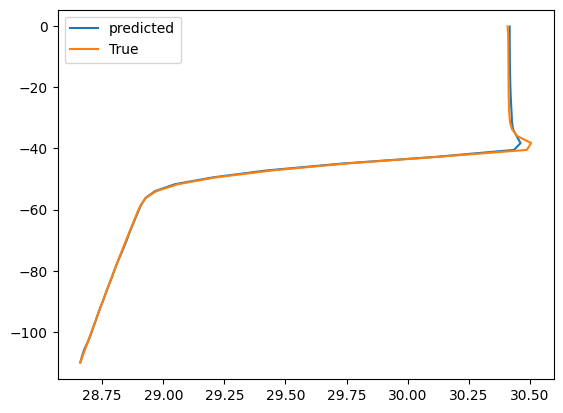

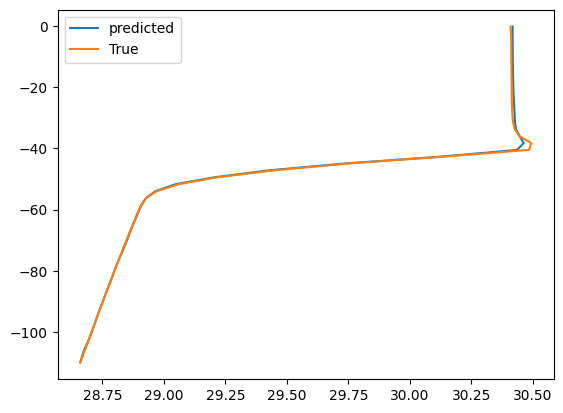

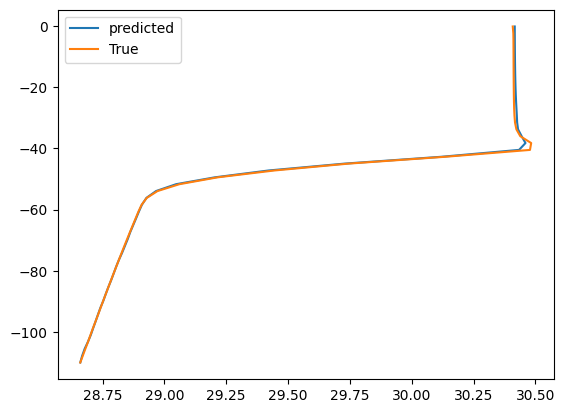

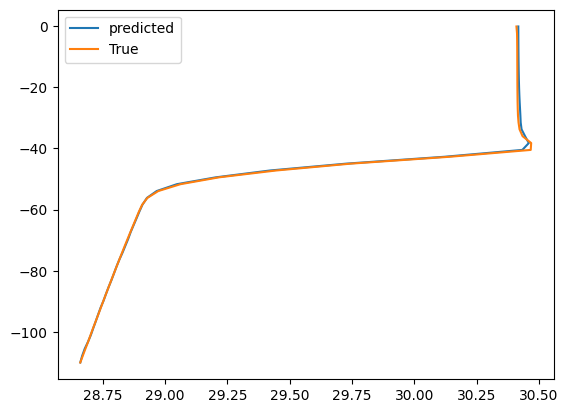

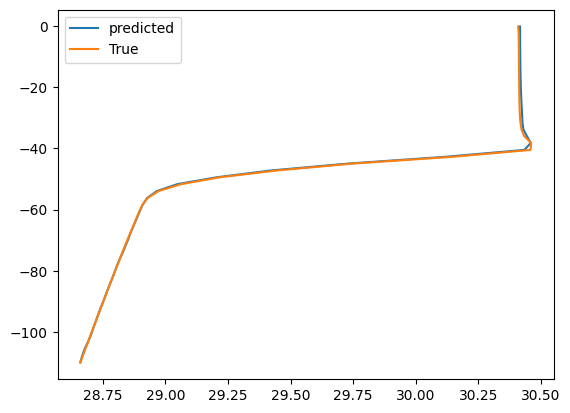

In [15]:
x_rec=torch.zeros((Valx_tr.shape[0],Valx_tr.shape[1],Valx_tr.shape[2]))
j=0
for i in range(Valx_tr.shape[0]):
    
    x_rec[i,:,:],_=model((torch.tensor(Valx_tr[i:i+1,:,:]).to(device)))
    if i%25==0:
        plt.figure(i)
        plt.plot(In.inv_transform(x_rec[i:i+1,:,:].detach().numpy())[:,:,0].T,xi.T,label='predicted')
        plt.plot(In.inv_transform(Valx_tr[i:i+1,:,:])[:,:,0].T,xi.T,label='True')
        plt.legend()
    j=j+1

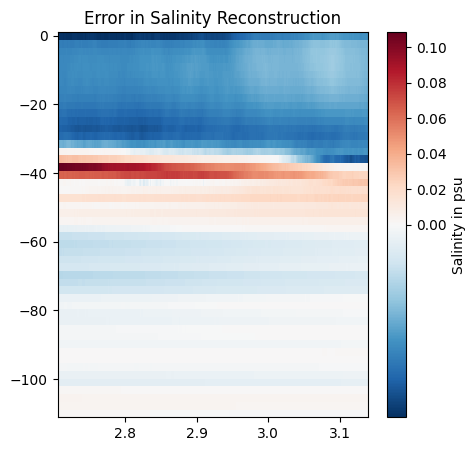

In [16]:
fig,ax=plt.subplots(1,1,figsize=(5,5))
from matplotlib.colors import TwoSlopeNorm
[xx, tt] = np.meshgrid(xi.flatten(), hours[1200:1500]/24)
norm = TwoSlopeNorm(vmin=np.min(In.inv_transform(Valx_tr[:,:,:])[:,:,0]-In.inv_transform(x_rec[:,:,:].cpu().detach().numpy())[:,:,0]), vcenter=0, vmax=np.max(In.inv_transform(Valx_tr[:,:,:])[:,:,0]-In.inv_transform(x_rec[:,:,:].cpu().detach().numpy())[:,:,0]))
im=ax.pcolormesh(tt,xx,In.inv_transform(Valx_tr[:,:,:])[:,:,0]-In.inv_transform(x_rec[:,:,:].cpu().detach().numpy())[:,:,0],label='predicted',norm=norm, cmap="RdBu_r")


#im=ax.pcolormesh(tt,xx,In.inv_transform(Testx_tr[time_step:,:,:])[:,:,0]-In.inv_transform(x_rec[time_step:,:,:].cpu().detach().numpy())[:,:,0],label='predicted')
ax.set_title('Error in Salinity Reconstruction')

colo=plt.colorbar(im, ax=ax)
colo.set_label('Salinity in psu')
plt.show()

## Testing

In [17]:
Testx=Input[1500-time_step_test:3000,:,0:1] ## C
Testx_tr=In.transform(Testx)
#Testx_tr=torch.from_numpy(Text_tr).float().to(device)
print(Testx_tr.shape)

(1510, 50, 1)


In [19]:
'''Testx=Input[7000-time_step_test:,:,1:2] ## C
Testx_tr=In.transform(Testx)
#Testx_tr=torch.from_numpy(Text_tr).float().to(device)
print(Testx_tr.shape)'''

'Testx=Input[7000-time_step_test:,:,1:2] ## C\nTestx_tr=In.transform(Testx)\n#Testx_tr=torch.from_numpy(Text_tr).float().to(device)\nprint(Testx_tr.shape)'

/var/folders/h3/x74z3jyn2rng1bhswhgq53x00000gn/T/ipykernel_66290/3511465924.py:7: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(i)


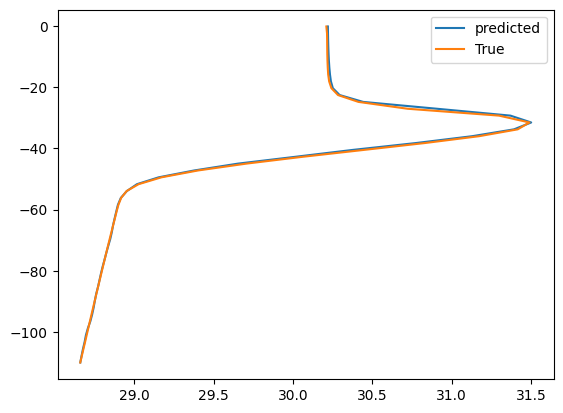

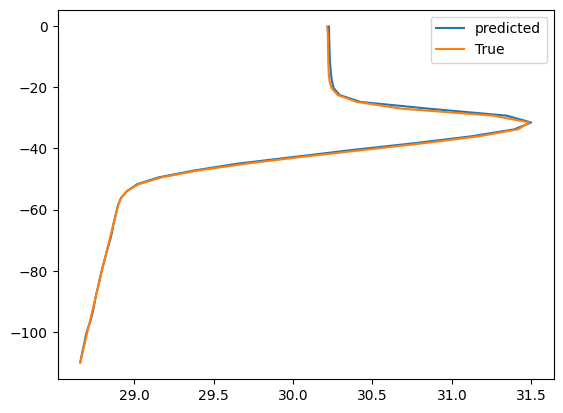

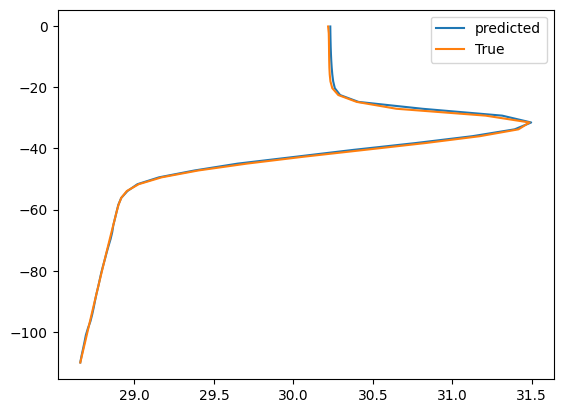

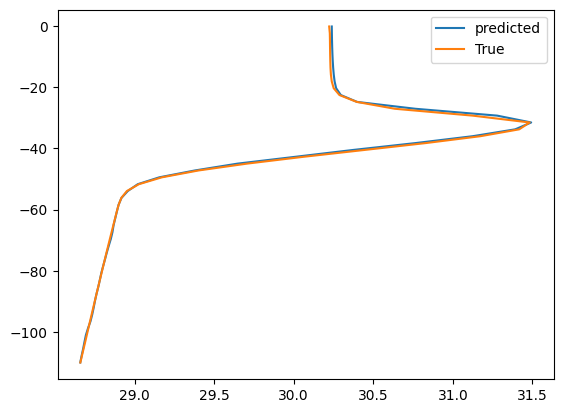

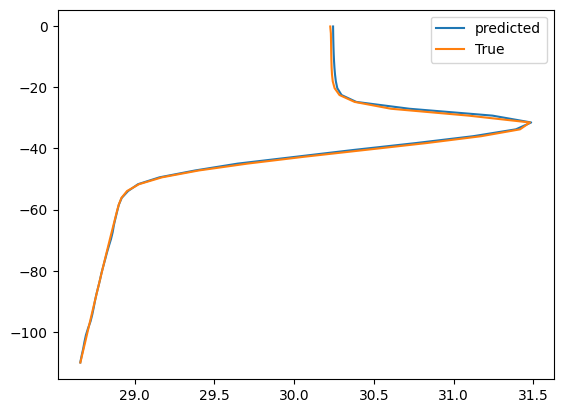

...

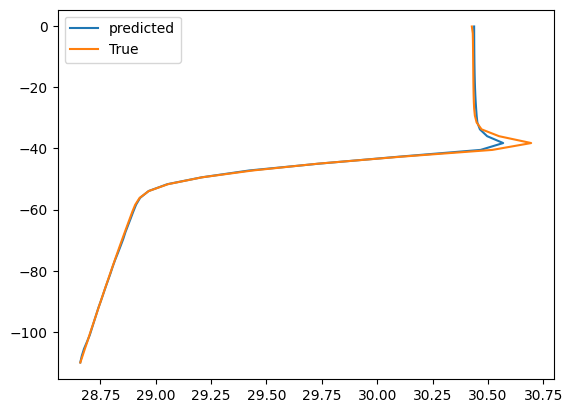

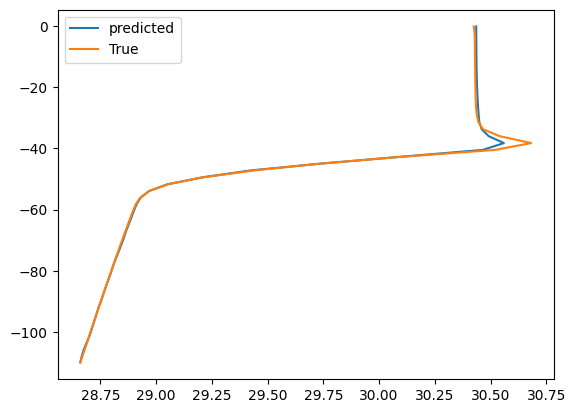

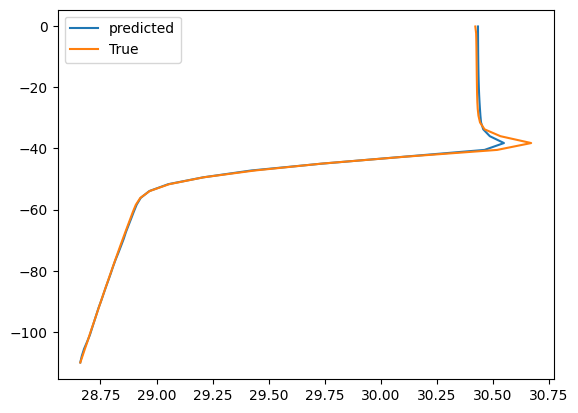

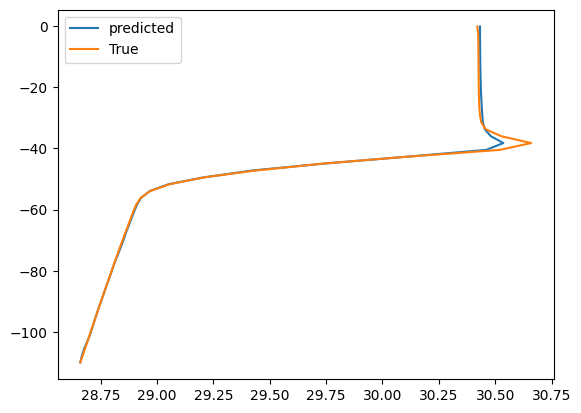

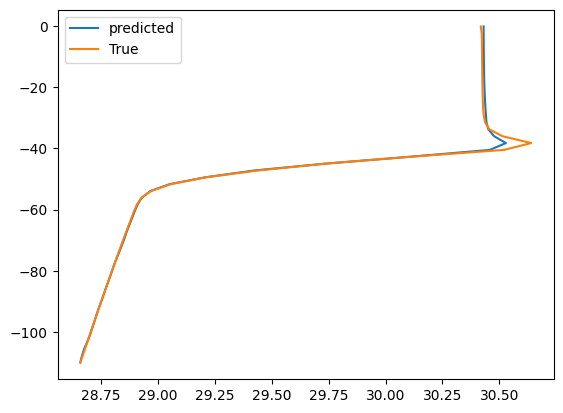

In [18]:
x_rec=torch.zeros((Testx_tr.shape[0],x_tr.shape[1],x_tr.shape[2]))
j=0
for i in range(Testx_tr.shape[0]):
    
    x_rec[i,:,:],_=model((torch.tensor(Testx_tr[i:i+1,:,:]).to(device)))
    if i%25==0:
        plt.figure(i)
        plt.plot(In.inv_transform(x_rec[i:i+1,:,:].detach().numpy())[:,:,0].T,xi.T,label='predicted')
        plt.plot(In.inv_transform(Testx_tr[i:i+1,:,:])[:,:,0].T,xi.T,label='True')
        plt.legend()
    j=j+1

In [19]:
x_rec1=np.zeros((x_rec.shape[0],240,1))
Testx_tr1=np.zeros((Testx_tr.shape[0],240,1))
days=hours/24
for i in range(Testx_tr.shape[0]): 
    x_rec1[i,:,:]=griddata(xi,x_rec[i,:,0:1].cpu().detach().numpy(),points,method='cubic')
    Testx_tr1[i,:,:]=griddata(xi,Testx_tr[i,:,0:1],points,method='cubic')
    
print(x_rec1.shape)
print(Testx_tr1.shape)

x_rec1=torch.from_numpy(x_rec1)

(1510, 240, 1)
(1510, 240, 1)


/var/folders/h3/x74z3jyn2rng1bhswhgq53x00000gn/T/ipykernel_66290/1182836400.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(i)


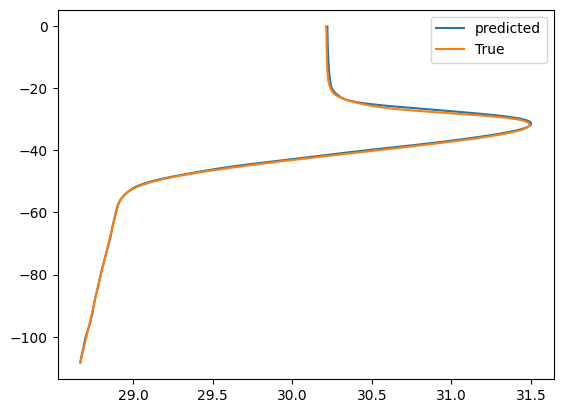

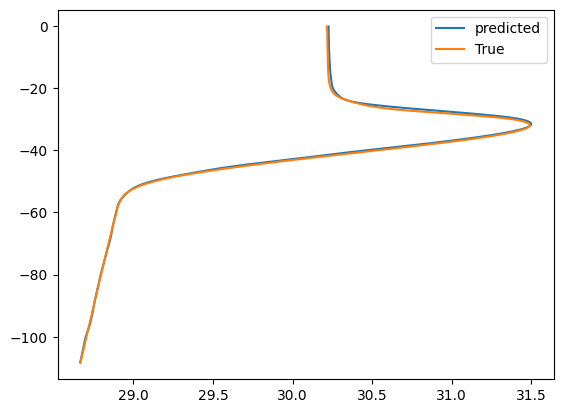

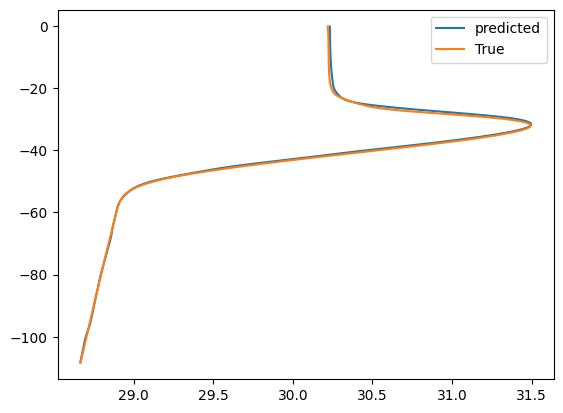

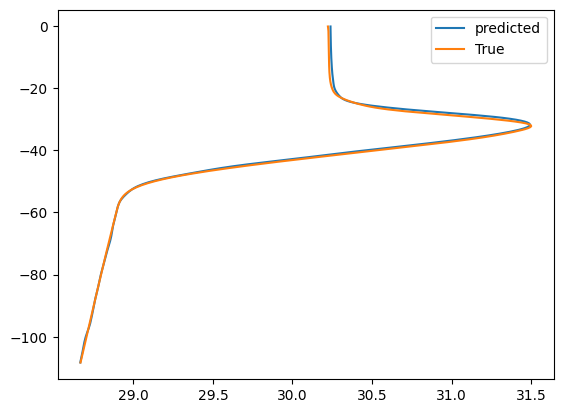

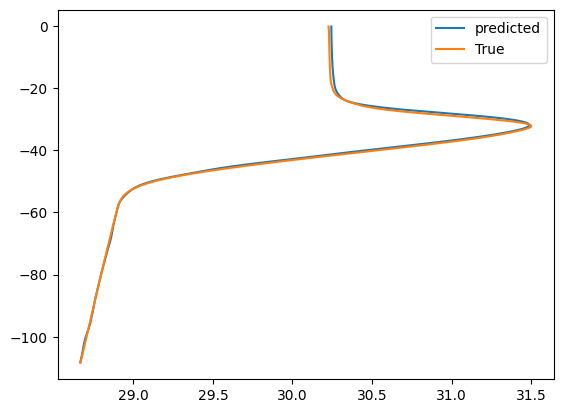

...

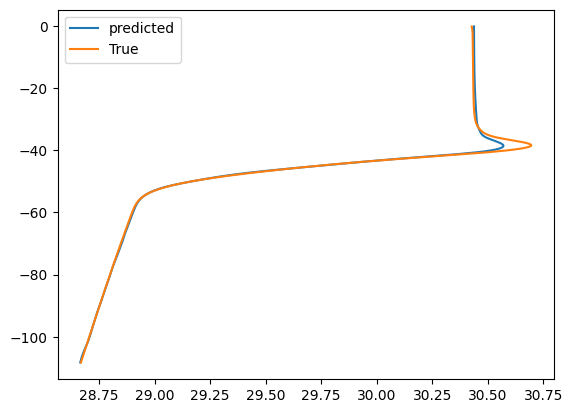

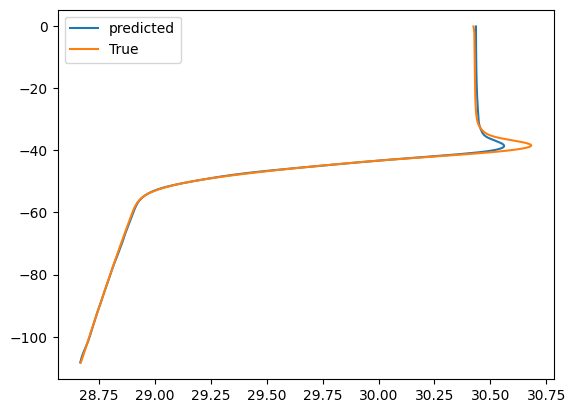

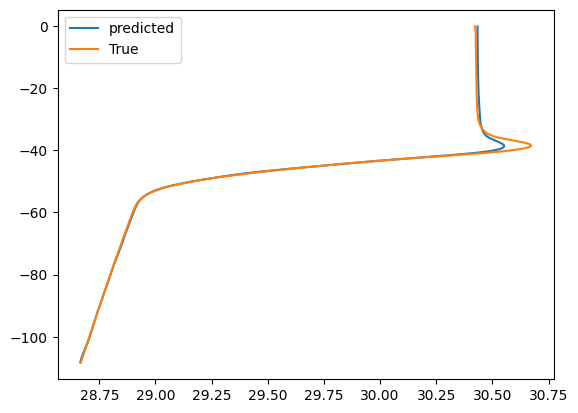

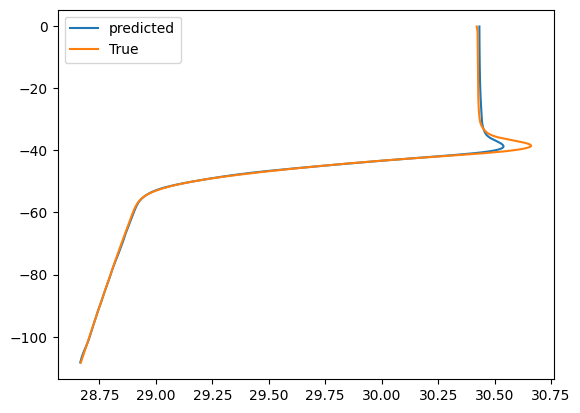

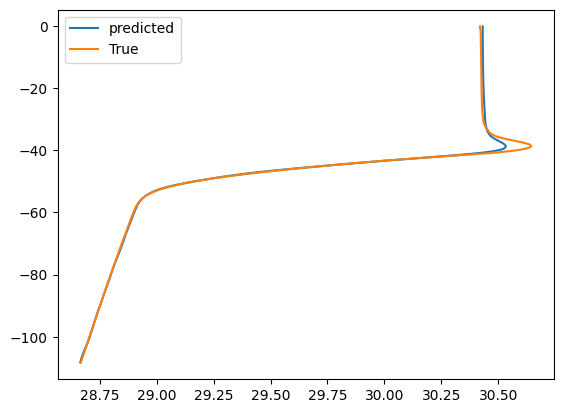

In [20]:
for i in range(Testx_tr.shape[0]):
    if i%25==0:
        plt.figure(i)
        plt.plot(In.inv_transform(x_rec1[i:i+1,:,:].detach().numpy())[:,:,0].T,ZZ.T,label='predicted')
        plt.plot(In.inv_transform(Testx_tr1[i:i+1,:,:])[:,:,0].T,ZZ.T,label='True')
        plt.legend()
    j=j+1

In [23]:
print(np.isnan(x_rec1[:,1:,:]).sum())

tensor(0)


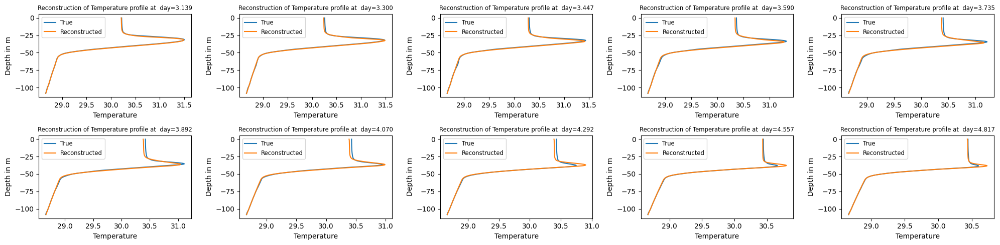

In [21]:
fig, ax = plt.subplots(2,5, figsize=(20,5))

p = 0
timeSteps=p+1500
for i in range(2):
    for j in range(5):
        ax[i, j].plot(In.inv_transform(x_rec1[p,:,:].detach().numpy())[:,:,0].T,ZZ.T,label='Reconstructed')
        ax[i, j].plot(In.inv_transform(Testx_tr1[p,:,:])[:,:,0].T,ZZ.T,label='True')
        ax[i, j].legend(['True', 'Reconstructed'], fontsize='small')
        ax[i, j].set_xlabel('Temperature')
        ax[i, j].set_ylabel('Depth in m')
        ax[i, j].set_title(f'Reconstruction of Temperature profile at  day=%1.3f' % days[timeSteps], fontsize='small')
        p += 150
        timeSteps += 150

plt.tight_layout()
plt.show()

'print(In.inv_transform(x_rec.detach().numpy())[:,-1,0])\nprint((x)[:,-1,0])'

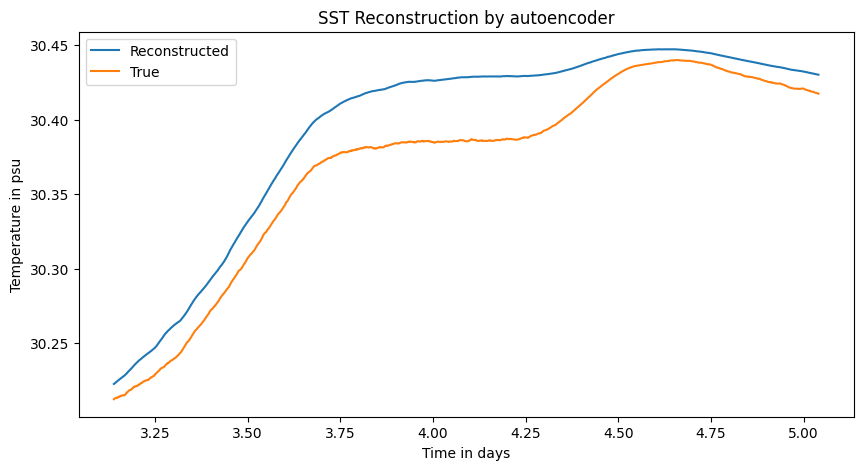

In [22]:
fig,ax= plt.subplots(1,1,figsize=(10,5))

ax.plot(days[1500:3000],In.inv_transform(x_rec1.detach().numpy())[time_step:,-1,0],label='Reconstructed')
ax.plot(days[1500:3000],In.inv_transform(Testx_tr1)[time_step:,-1,0],label='True')
ax.set_title('SST Reconstruction by autoencoder')
ax.set_xlabel('Time in days')
ax.set_ylabel('Temperature in psu')

ax.legend()
'''ax[1].plot(In.inv_transform(x_rec.detach().numpy())[:,-1,1],label='Predicted')
ax[1].plot(In.inv_transform(Testx_tr)[:,-1,1],label='True')
ax[1].legend()'''

'''print(In.inv_transform(x_rec.detach().numpy())[:,-1,0])
print((x)[:,-1,0])'''




Text(0.04, 0.45, 'Depth (meters)')

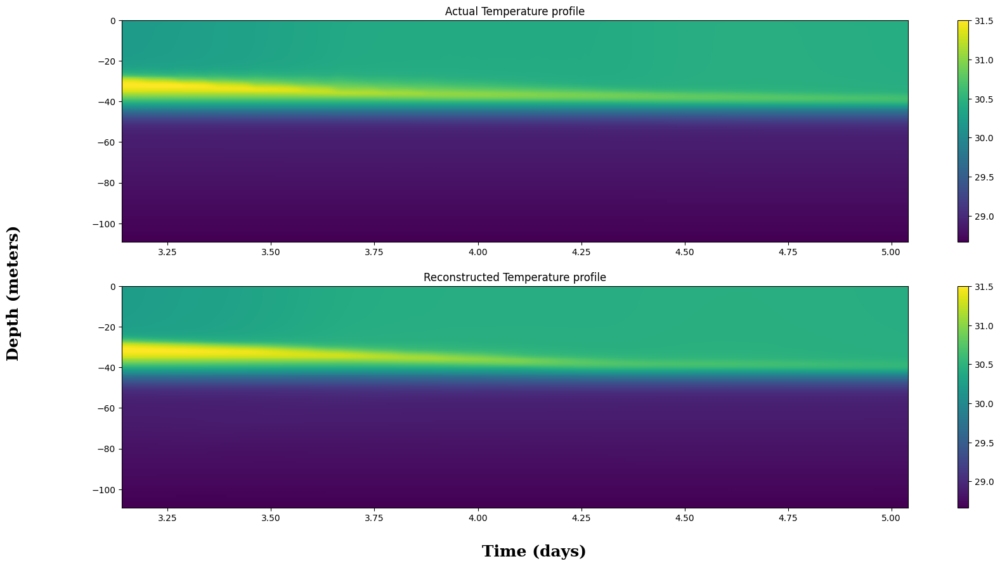

In [23]:
#pcolor plots
t=np.linspace(1500,3500,2000,endpoint=False)
[xx, tt] = np.meshgrid(ZZ[:,1:].flatten(), hours[1500:3000]/24)
label_font = {'family': 'serif', 'weight': 'bold', 'size': 18}
fig,ax=plt.subplots(2,1,figsize=(20,10))
'''ax[0].pcolormesh(tt,xx,In.inv_transform(Testx_tr[time_step:,:,:])[:,:,1],label='Actual')
ax[1].pcolormesh(tt,xx,In.inv_transform(x_rec[time_step:,:,:].cpu().detach().numpy())[:,:,1],label='predicted')
ax[0].set_title(' Actual Salinity profile')
ax[1].set_title('Reconstructed salinity profile')'''

a=ax[1].pcolormesh(tt,xx,In.inv_transform(x_rec1[time_step:,:,:].cpu().detach().numpy())[:,1:,0],label='predicted')
b=ax[0].pcolormesh(tt,xx,In.inv_transform(Testx_tr1[time_step:,:,:])[:,1:,0],label='actual')
ax[1].set_title('Reconstructed Temperature profile')
ax[0].set_title('Actual Temperature profile')
fig.colorbar(b,ax=ax[0])
fig.colorbar(a,ax=ax[1])

fig.text(0.45, 0.04, 'Time (days)', ha='center', va='center',font=label_font)
fig.text(0.04, 0.45, 'Depth (meters)', ha='center', va='center', rotation='vertical',font=label_font)


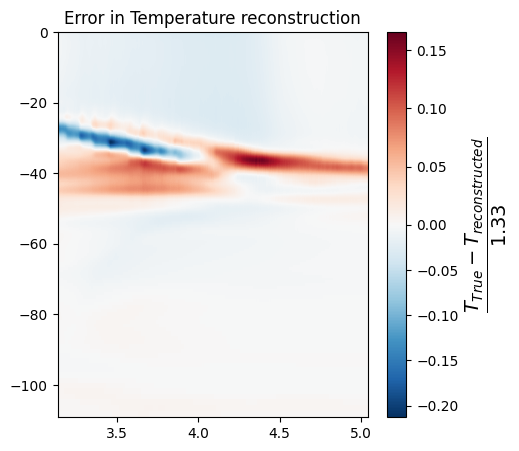

In [24]:
'''fig,ax=plt.subplots(1,1,figsize=(5,5))
im=ax.pcolormesh(tt,xx,In.inv_transform(x_rec[time_step:,:,:].cpu().detach().numpy())[:,:,1]-In.inv_transform(Testx_tr[time_step:,:,:])[:,:,1],label='predicted')
ax.set_title('Error for Salinity Reconstruction')

colo=plt.colorbar(im, ax=ax)
colo.set_label('Salinity erro in psu')
plt.show()'''

fig,ax=plt.subplots(1,1,figsize=(5,5))
plt.rcParams['text.usetex'] = False
from matplotlib.colors import TwoSlopeNorm

norm = TwoSlopeNorm(vmin=np.min(In.inv_transform(Testx_tr1[time_step:,:,:])[:,1:,0]/1.33-In.inv_transform(x_rec1[time_step:,:,:].cpu().detach().numpy())[:,1:,0]/1.33), vcenter=0, vmax=np.max(In.inv_transform(Testx_tr1[time_step:,:,:])[:,1:,0]/1.33-In.inv_transform(x_rec1[time_step:,:,:].cpu().detach().numpy())[:,1:,0]/1.33))

im=ax.pcolormesh(tt,xx,In.inv_transform(Testx_tr1[time_step:,:,:])[:,1:,0]/1.33-In.inv_transform(x_rec1[time_step:,:,:].cpu().detach().numpy())[:,1:,0]/1.33,label='predicted',norm=norm, cmap="RdBu_r")


#im=ax.pcolormesh(tt,xx,In.inv_transform(Testx_tr[time_step:,:,:])[:,:,0]-In.inv_transform(x_rec[time_step:,:,:].cpu().detach().numpy())[:,:,0],label='predicted')
ax.set_title('Error in Temperature reconstruction')

colo=plt.colorbar(im, ax=ax)

colo.set_label(r'$\frac{T_{True}-T_{reconstructed}}{1.33}$',fontsize=20)
#colo.set_label('Temperature (\u00b0C)')
plt.show()

In [25]:
# Data for training LSTM and DNN

out,reduced_Train= model((torch.tensor(x_tr[:,:,:]).to(device)))

outv,reduced_val=model(torch.tensor(Valx_tr[:,:,:]).to(device))

outT,reduced_test=model(torch.tensor(Testx_tr[:,:,:]).to(device))

print(reduced_Train.shape)
print(reduced_val.shape)
print(reduced_test.shape)

torch.Size([6701, 3])
torch.Size([300, 3])
torch.Size([1510, 3])


In [26]:
# interpolated and change of Training data.
reduced_all=torch.cat([reduced_Train[0:1500],reduced_test[time_step:time_step+1500],reduced_val,reduced_Train[1500:]])

In [27]:
filename1='reduced_all.mat'

reduced_al={'red_all':reduced_all.cpu().detach().numpy()}

scipy.io.savemat(filename1,reduced_al)


Text(0.5, 0.98, 'Evolution of three Latent space variables ')

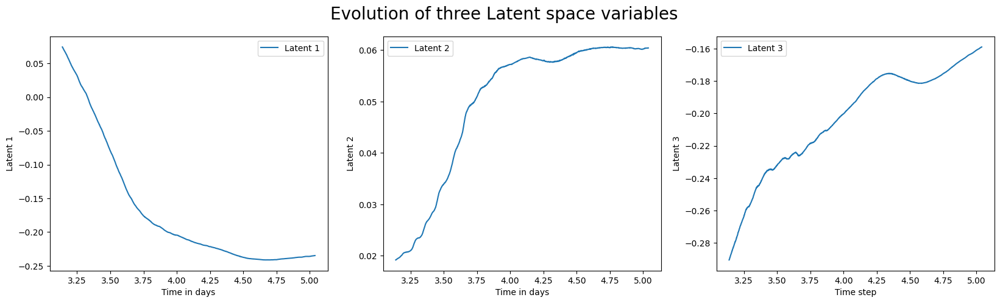

In [28]:
fig, ax = plt.subplots(1,3, figsize=(20, 5))
Start=1500
End=3000
stride=1

#ax[0].plot(Test_encodings_actual[Start:End:stride, 0],label='Actual')
ax[0].plot(days[Start:End],reduced_all.cpu().detach().numpy()[Start:End:stride, 0],label='Latent 1')
#ax[0].plot(days[1500:3000],reduced_all.cpu().detach().numpy()[1500:3000, 0],label='Latent 1')
ax[0].set_xlabel('Time in days')
ax[0].set_ylabel('Latent 1')

#ax[1].plot(Test_encodings_actual[Start:End:stride, 1],label='Actual')
ax[1].plot(days[Start:End],reduced_all.cpu().detach().numpy()[Start:End:stride, 1],label='Latent 2')
#ax[1].plot(days[1500:3000],reduced_all.cpu().detach().numpy()[1500:3000, 1],label='Latent 2')
ax[1].set_xlabel('Time in days')
ax[1].set_ylabel('Latent 2')

#ax[2].plot(Test_encodings_actual[Start:End:stride, 2],label='Actual')
ax[2].plot(days[Start:End],reduced_all.cpu().detach().numpy()[Start:End:stride, 2],label='Latent 3')
#ax[2].plot(days[1500:3000],reduced_all.cpu().detach().numpy()[1500:3000, 2],label='Latent 3')
ax[2].set_xlabel('Time step')
ax[2].set_ylabel('Latent 3')
ax[0].legend()
ax[1].legend()
ax[2].legend()

plt.suptitle('Evolution of three Latent space variables ',fontsize=20)


In [29]:
# Considering interpolationa nd change of dataset
Input_BC=loadmat("Input_BC")
B_C=Input_BC['BC'].astype(np.float32)

BC1=B_C[0:1500,[1,2,3,4]]
BC2=B_C[3300:8501,[1,2,3,4]]


BC_train=np.concatenate([BC1,BC2],axis=0)

bc=MinMaxScaler()
BC_train=bc.fit_transform(BC_train)
BC_val=B_C[3000:3300,[1,2,3,4]]

BC_val=bc.transform(BC_val)

BC_test=B_C[1500-time_step_test:3000,[1,2,3,4]]
BC_test=bc.transform(BC_test)
print(BC_test.shape)
print(B_C.shape)

(1510, 4)
(8501, 6)


In [30]:
print(BC_train.shape)
print(BC_val.shape)
print(BC_test.shape)

(6701, 4)
(300, 4)
(1510, 4)


In [31]:
BC_cond=4

## Preparing data for Temporal Evolution

In [32]:
# Considering interpolation and change of training dataset
Train_In=np.zeros((reduced_Train.shape[0]-time_step*4,time_step,encoded_size+BC_cond))
Train_Out=np.zeros((reduced_Train.shape[0]-time_step*4,encoded_size*time_step))

print(reduced_Train.shape)

j=0
for i in range(0,1500-2*time_step):
    Train_In[j,:,0:encoded_size]=reduced_Train[i:i+time_step,:].cpu().detach().numpy()
    Train_In[j,:,encoded_size:]=BC_train[i:i+time_step,:]
    Train_Out[j,:]=(reduced_Train[i+time_step:i+2*time_step,:].cpu().detach().numpy()).reshape(1,encoded_size*time_step)
    j=j+1
    
for i in range(1500,6701-2*time_step):
    Train_In[j,:,0:encoded_size]=reduced_Train[i:i+time_step,:].cpu().detach().numpy()
    Train_In[j,:,encoded_size:]=BC_train[i:i+time_step,:]
    Train_Out[j,:]=(reduced_Train[i+time_step:i+2*time_step,:].cpu().detach().numpy()).reshape(1,encoded_size*time_step)
    j=j+1



Val_In=np.zeros((reduced_val.shape[0]-2*time_step,time_step,encoded_size+BC_cond))
Val_Out=np.zeros((reduced_val.shape[0]-2*time_step,encoded_size*time_step))


for i in range(300-2*time_step):
    Val_In[i,:,0:encoded_size]=reduced_val[i:i+time_step,:].cpu().detach().numpy()
    Val_In[i,:,encoded_size:]=BC_val[i:i+time_step,:]
    Val_Out[i,:]=reduced_val[i+time_step:i+2*time_step,:].cpu().detach().numpy().reshape(1,encoded_size*time_step)

print(Val_In.shape)

Test_In=np.zeros((reduced_test.shape[0]-2*time_step,time_step,encoded_size+BC_cond))
Test_Out=np.zeros((reduced_test.shape[0]-2*time_step,encoded_size*time_step))


for i in range(0,1500-time_step):
    Test_In[i,:,0:encoded_size]=reduced_test[i:i+time_step,:].cpu().detach().numpy()
    Test_In[i,:,encoded_size:]=BC_test[i:i+time_step,:]
    Test_Out[i,:]=reduced_test[i+time_step:i+2*time_step,:].cpu().detach().numpy().reshape(1,encoded_size*time_step)

print(Test_In.shape)

torch.Size([6701, 3])
(280, 10, 7)
(1490, 10, 7)


In [33]:

print(Train_In.shape)
print(Train_Out.shape)

print(Val_In.shape)
print(Val_Out.shape)

print(Test_In.shape)
print(Test_Out.shape)

(6661, 10, 7)
(6661, 30)
(280, 10, 7)
(280, 30)
(1490, 10, 7)
(1490, 30)


In [34]:
filename1='TrainingIn.mat'

reduced_train_In={'red_train':Train_In}
filename2='TrainingOut.mat'
reduced_train_Out={'red_train':Train_Out}

scipy.io.savemat(filename1,reduced_train_In)
scipy.io.savemat(filename2,reduced_train_Out)

filename3='Validation_In.mat'
filename4='Validation_Out.mat'

reduced_val_In={'val_train':Val_In}
reduced_val_Out={'val_train':Val_Out}

scipy.io.savemat(filename3,reduced_val_In)
scipy.io.savemat(filename4,reduced_val_Out)


filename3='Test_In.mat'
filename4='Test_Out.mat'

reduced_test_In={'red_test':Test_In}
reduced_test_Out={'red_test':Test_Out}

scipy.io.savemat(filename3,reduced_test_In)
scipy.io.savemat(filename4,reduced_test_Out)

In [35]:
# Test initial condition
Test_In=np.zeros((1,time_step_test,encoded_size+BC_cond))

Test_In[0,:,0:encoded_size]=reduced_test[0:time_step_test,:].cpu().detach().numpy()
Test_In[0,:,encoded_size:]=BC_test[0:time_step_test,:]

filename5='Test_Inital.mat'
Test_init={'Test':Test_In}

scipy.io.savemat(filename5,Test_init)

filename6='BC_test.mat'
BC_test={'BC_test':BC_test}

scipy.io.savemat(filename6,BC_test)

Test_In_all=np.zeros((29,time_step_test,encoded_size))
print(reduced_test[time_step:,:].shape)

Test_In_all=reduced_test[time_step:,:].cpu().detach().numpy()

print(Test_In_all.shape)

filename7='Test_Set.mat'
Test_In_set={'Test_Set':Test_In_all}

scipy.io.savemat(filename7,Test_In_set)


torch.Size([1500, 3])
(1500, 3)


In [36]:
# Validation Initial condition 
Val_In=np.zeros((1,time_step_test,encoded_size+BC_cond))

Val_In[0,:,0:encoded_size]=reduced_val[0:time_step_test,:].cpu().detach().numpy()
Val_In[0,:,encoded_size:]=BC_val[0:time_step_test,:]

filename5='Val_Inital.mat'
Val_init={'Val':Val_In}

scipy.io.savemat(filename5,Val_init)

filename6='BC_val.mat'
BC_val={'BC_val':BC_val}

scipy.io.savemat(filename6,BC_val)

Val_In_all=np.zeros((29,time_step_test,encoded_size))
print(reduced_val[:,:].shape)

Val_In_all=reduced_val[:,:].cpu().detach().numpy()

print(Val_In_all.shape)

filename7='Val_Set.mat'
Val_In_set={'Val_Set':Val_In_all}

scipy.io.savemat(filename7,Val_In_set)


torch.Size([300, 3])
(300, 3)


## Decoding from predictions 

In [42]:
pred=loadmat('predictions_encodings.mat')
predictions_enc=pred['pred']
print(predictions_enc.shape)
predictions_enc=torch.from_numpy(predictions_enc).float().to(device)

(1500, 3)


In [43]:
x=torch.zeros(3000, 240, 5).to(device)

In [44]:
decoded_predictions=model.decoder(predictions_enc,x)


In [45]:
Truex=Input[1500:3000,:,:]
True_tr=In.transform(Truex)



In [46]:
decoded_predictions1=np.zeros((decoded_predictions.shape[0],240,1))
True_tr1=np.zeros((True_tr.shape[0],240,1))

for i in range(decoded_predictions.shape[0]): 
    decoded_predictions1[i,:,:]=griddata(xi,decoded_predictions[i,:,0:1].cpu().detach().numpy(),points,method='cubic')
    True_tr1[i,:,:]=griddata(xi,True_tr[i,:,0:1],points,method='cubic')
    
print(decoded_predictions1.shape)
#print(True_tr1.shape)

decoded_predictions=torch.from_numpy(decoded_predictions1)
True_tr=torch.from_numpy(True_tr1)

(1500, 240, 1)


In [55]:
'''Truex=Input[7000:,:,:]
True_tr=In.transform(Truex)'''

'Truex=Input[7000:,:,:]\nTrue_tr=In.transform(Truex)'

In [56]:
print(decoded_predictions.shape)
print(True_tr.shape)

torch.Size([1500, 240, 1])
torch.Size([1500, 240, 1])


/tmp/ipykernel_1485/721862860.py:9: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(i)


'os.chdir("images")\nsubprocess.call([\n        \'ffmpeg\', \'-framerate\', \'8\', \'-i\', \'file%02d.png\', \'-r\', \'30\', \'-pix_fmt\', \'yuv420p\',\n        \'Salinity.mp4\'])\n'

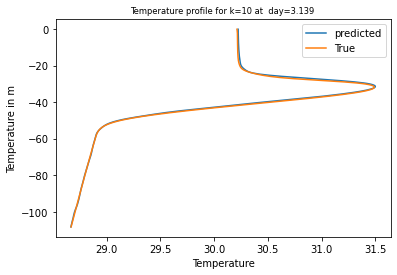

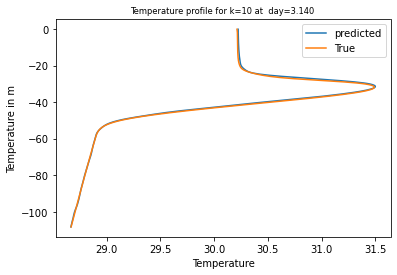

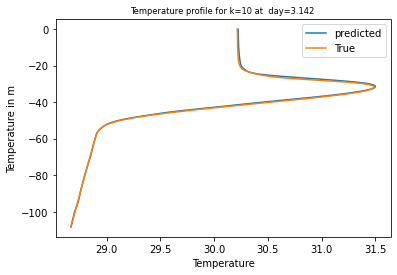

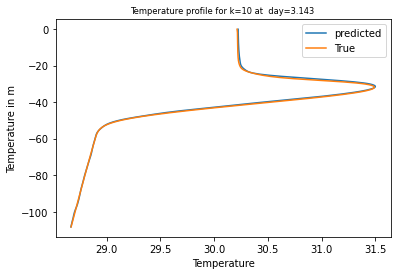

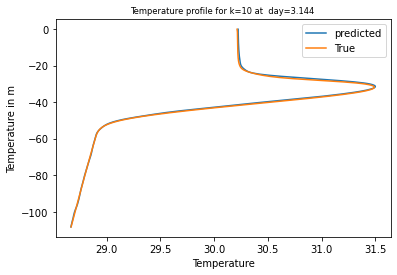

...

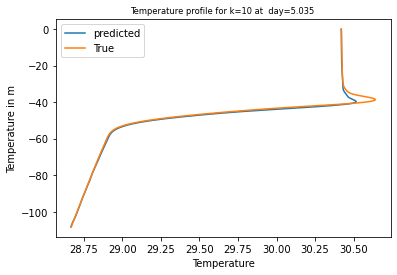

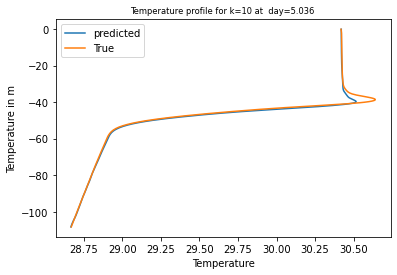

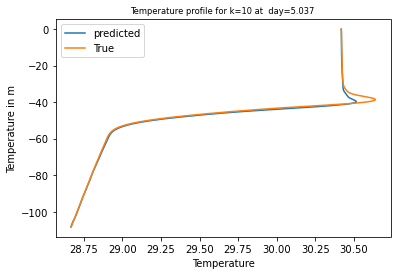

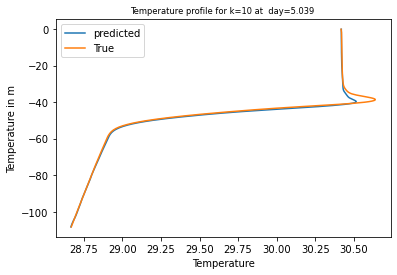

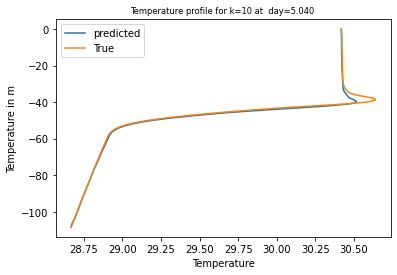

In [99]:
folder = "images_Temperature_1500-3000_latest"
import os
p=0
days=hours/24
timeSteps=p+1500
os.makedirs(folder, exist_ok=True)
for i in range(0,1500):#decoded_predictions.shape[0]):
    #if i%25==0:
        plt.figure(i)
        plt.plot(In.inv_transform(decoded_predictions[i:i+1,:,:].cpu().detach().numpy())[:,:,0].T,ZZ.T,label='predicted')
        plt.plot(In.inv_transform(True_tr[i:i+1,:,:].cpu().detach().numpy())[:,:,0].T,ZZ.T,label='True')
        plt.xlabel('Temperature')
        plt.ylabel('Temperature in m')
        plt.title(f'Temperature profile for k={time_step} at  day=%1.3f ' % days[timeSteps], fontsize='small')
        plt.legend()
        plt.savefig(folder + "/file%02d.png" % i)
        timeSteps=timeSteps+1
'''os.chdir("images")
subprocess.call([
        'ffmpeg', '-framerate', '8', '-i', 'file%02d.png', '-r', '30', '-pix_fmt', 'yuv420p',
        'Salinity.mp4'])
'''

        

In [100]:
import os
import subprocess
os.chdir(folder)
subprocess.call([
        'ffmpeg', '-framerate', '32', '-i', 'file%02d.png', '-r', '60', '-pix_fmt', 'yuv420p',
        'Temperature1.mp4'])


ffmpeg version 4.2.4-1ubuntu0.1 Copyright (c) 2000-2020 the FFmpeg developers
  built with gcc 9 (Ubuntu 9.3.0-10ubuntu2)
  configuration: --prefix=/usr --extra-version=1ubuntu0.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --enable-avresample --disable-filter=resample --enable-avisynth --enable-gnutls --enable-ladspa --enable-libaom --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libjack --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librsvg --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvidstab --enable-libvorbis --enable-l

0

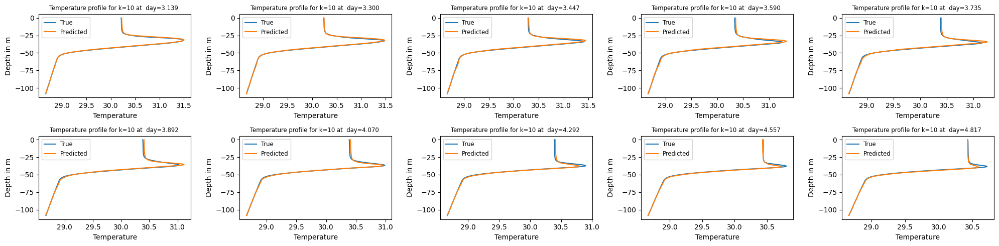

In [47]:
fig, ax = plt.subplots(2,5, figsize=(20, 5))
p = 0
days=hours/24
timeSteps=p+1500
for i in range(2):
    for j in range(5):
        ax[i, j].plot(In.inv_transform(True_tr[p,:,:].cpu().detach().numpy())[:,:,0].T,ZZ.T,label='True')
        ax[i, j].plot(In.inv_transform(decoded_predictions[p,:,:])[:,:,0].T,ZZ.T,label='predicted')
        ax[i, j].legend(['True', 'Predicted'], fontsize='small')
        ax[i, j].set_xlabel('Temperature')
        ax[i, j].set_ylabel('Depth in m')
        ax[i, j].set_title(f'Temperature profile for k={time_step} at  day=%1.3f ' % days[timeSteps], fontsize='small')
        p += 150
        timeSteps += 150

plt.tight_layout()
plt.show()

"ax[0].plot(In.inv_transform(decoded_predictions[:,:,:].cpu().detach().numpy())[:,-1,1], label='Predicted')\nax[0].plot(In.inv_transform(True_tr)[:,-1,1], label='True')\nax[0].set_title(f'Comparison between LES and LSTM-ROM SSS for k={time_step}')\nax[0].legend()"

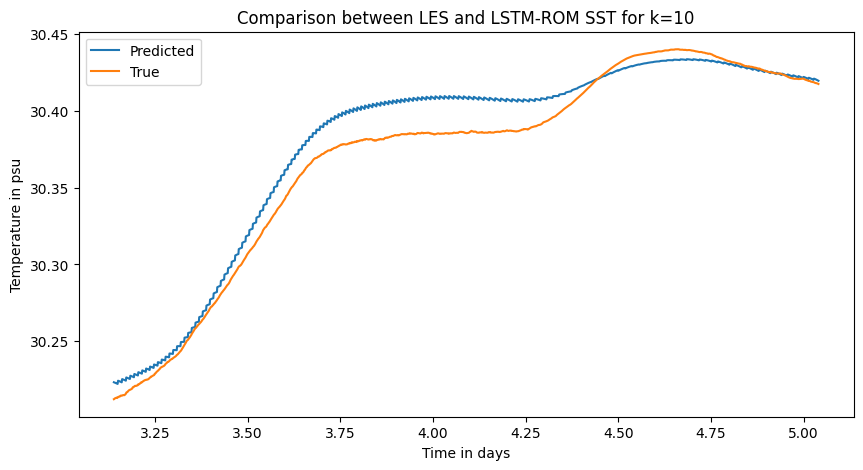

In [48]:
fig,ax= plt.subplots(1,1,figsize=(10,5))
ax.plot(hours[1500:3000]/24,In.inv_transform(decoded_predictions[:,:,:])[:,-1,], label='Predicted')
ax.plot(hours[1500:3000]/24,In.inv_transform(True_tr.cpu().detach().numpy())[:,-1,0], label='True')
ax.set_xlabel('Time in days')
ax.set_ylabel('Temperature in psu')
ax.set_title(f'Comparison between LES and LSTM-ROM SST for k={time_step}')
ax.legend()
'''ax[0].plot(In.inv_transform(decoded_predictions[:,:,:].cpu().detach().numpy())[:,-1,1], label='Predicted')
ax[0].plot(In.inv_transform(True_tr)[:,-1,1], label='True')
ax[0].set_title(f'Comparison between LES and LSTM-ROM SSS for k={time_step}')
ax[0].legend()'''

Text(0.04, 0.45, 'Depth (meters)')

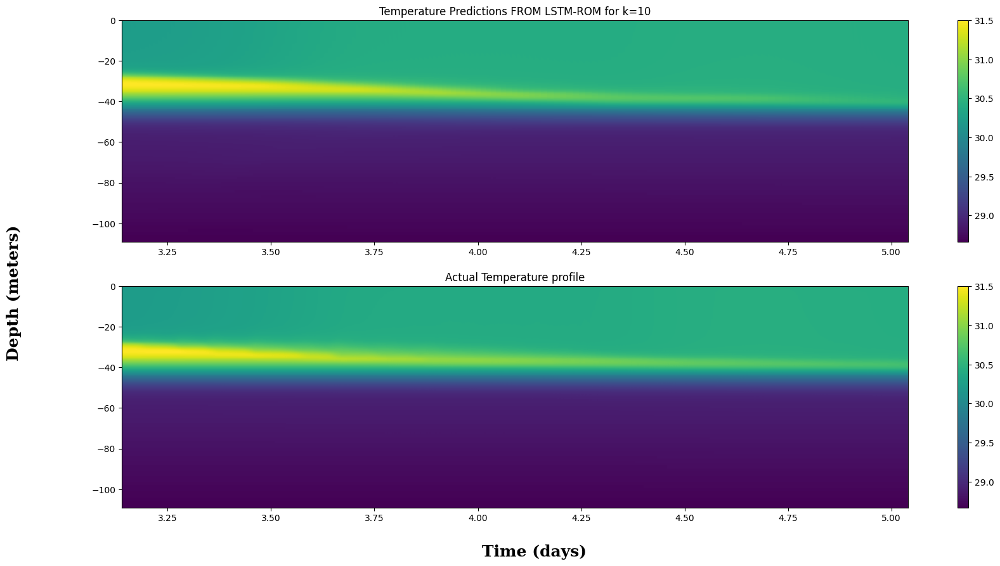

In [49]:
#pcolor plots
t=np.linspace(1000,4999,3999,endpoint=False)
[xx, tt] = np.meshgrid(ZZ[:,1:].flatten(), days[1500:3000])
label_font = {'family': 'serif', 'weight': 'bold', 'size': 18}
fig,ax=plt.subplots(2,1,figsize=(20,10))
'''ax[1].pcolormesh(tt,xx,In.inv_transform(True_tr[:,:,:])[:,:,1],label='Actual')
ax[0].pcolormesh(tt,xx,In.inv_transform(decoded_predictions[:,:,:].cpu().detach().numpy())[:,:,1],label='predicted')
ax[1].set_title(' Actual Salinity profile')
ax[0].set_title(f'Salinity Predictions from LSTM-ROM for k={time_step}')'''

b=ax[0].pcolormesh(tt,xx,In.inv_transform(decoded_predictions[:,:,:].cpu().detach().numpy())[:,1:,0],label='predicted')
a=ax[1].pcolormesh(tt,xx,In.inv_transform(True_tr[:,:,:])[:,1:,0],label='actual')
ax[1].set_title('Actual Temperature profile')
ax[0].set_title(f'Temperature Predictions FROM LSTM-ROM for k={time_step}')
fig.colorbar(b,ax=ax[0])
fig.colorbar(a,ax=ax[1])

fig.text(0.45, 0.04, 'Time (days)', ha='center', va='center',font=label_font)
fig.text(0.04, 0.45, 'Depth (meters)', ha='center', va='center', rotation='vertical',font=label_font)


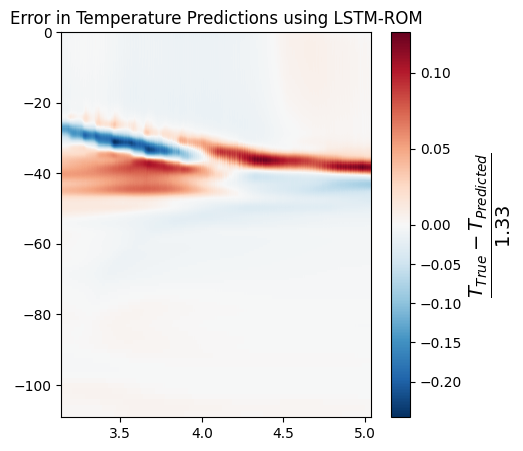

In [50]:
fig,ax=plt.subplots(1,1,figsize=(5,5))
#from matplotlib.colors import LinearSegmentedColormap
from matplotlib.colors import TwoSlopeNorm
#cmap = LinearSegmentedColormap.from_list('custom_cmap', colors = [(0, 'blue'), (0.5, 'white'), (1, 'red')] , N=256)

norm = TwoSlopeNorm(vmin=np.min(In.inv_transform(True_tr[:,:,:].cpu().detach().numpy())[:,1:,0]/1.33-In.inv_transform(decoded_predictions[:,:,:].cpu().detach().numpy())[:,1:,0]/1.33), vcenter=0, vmax=np.max(In.inv_transform(True_tr[:,:,:].cpu().detach().numpy())[:,1:,0]/1.33-In.inv_transform(decoded_predictions[:,:,:].cpu().detach().numpy())[:,1:,0]/1.33))


im=ax.pcolormesh(tt,xx,In.inv_transform(True_tr[:,:,:].cpu().detach().numpy())[:,1:,0]/1.33-In.inv_transform(decoded_predictions[:,:,:].cpu().detach().numpy())[:,1:,0]/1.33,label='predicted',norm=norm, cmap="RdBu_r")
ax.set_title('Error in Temperature Predictions using LSTM-ROM')

colo=plt.colorbar(im, ax=ax)
colo.set_label(r'$\frac{T_{True}-T_{Predicted}}{1.33}$',fontsize=20)
plt.show()

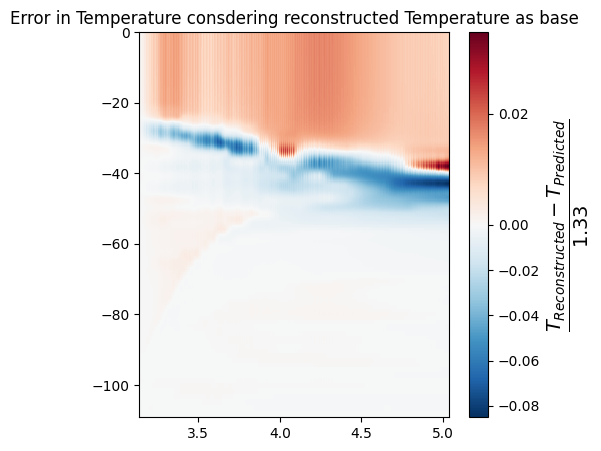

In [52]:
fig,ax=plt.subplots(1,1,figsize=(5,5))
from matplotlib.colors import TwoSlopeNorm

norm = TwoSlopeNorm(vmin=np.min(In.inv_transform(x_rec1[time_step:,:,:].cpu().detach().numpy())[:-1,1:,0]/1.33-In.inv_transform(decoded_predictions[:-1,1:,:].cpu().detach().numpy())[:,:,0]/1.33), vcenter=0, vmax=np.max(In.inv_transform(x_rec1[time_step:,:,:].cpu().detach().numpy())[:-1,1:,0]/1.33-In.inv_transform(decoded_predictions[:,:,:].cpu().detach().numpy())[:-1,1:,0]/1.33))




im=ax.pcolormesh(tt[:-1,:],xx[:-1,:],In.inv_transform(x_rec1[time_step:,:,:].cpu().detach().numpy())[:-1,1:,0]/1.33-In.inv_transform(decoded_predictions[:,:,:].cpu().detach().numpy())[:-1,1:,0]/1.33,label='predicted',norm=norm, cmap="RdBu_r")
ax.set_title('Error in Temperature consdering reconstructed Temperature as base')

colo=plt.colorbar(im, ax=ax)
colo.set_label(r'$\frac{T_{Reconstructed}-T_{Predicted}}{1.33}$',fontsize=20)
plt.show()
